In [1]:
import cv2 as cv
import glob, os
from scipy import signal
import numpy as np
import matplotlib.pyplot as plt

path = '/Users/estepark/Documents/week9_tues/images'
results = '/Users/estepark/Documents/week9_tues/results'
kern = [[0, 1,  0], [1, 0, -1],[ 0, -1 ,0]]

# for fname in glob.glob(path+'/*.Png'):
    
#     serNum = fname.split('/')[6] 
#     img  = cv.imread(fname)
#     imgray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
#     imgFilt = cv.bilateralFilter(imgray, 15, 75, 75)
    
#     diag_img = signal.convolve2d(imgFilt, np.array(kern), boundary='symm', mode='same')
#     diag_cpy = (((diag_img+2))/4*255).astype(np.uint8) #bc min=-2 and max=+2
    
#     print(diag_cpy)
#     plt.figure()
#     plt.title(serNum)
#     plt.imshow(diag_img)
#     plt.show()
#     cv.imwrite(os.path.join(results, serNum), diag_cpy)
    


In [2]:
labels =  '/Users/estepark/Documents/week9_tues/label'

for fname in glob.glob(labels+'/*.png'):

    print(fname)
    serNum = fname.split('/')[6] 
    print(serNum)
    img  = cv.imread(fname)
    label = cv.imread('./images/{}'.format(serNum))
    label_2 = cv.imread('./results/{}'.format(serNum))
    label_2 = cv.cvtColor(label_2, cv.COLOR_BGR2GRAY)
    label_2 = label_2/255
    label = cv.cvtColor(label, cv.COLOR_BGR2GRAY)
    #label = label/255
    label = (label-np.min(label))/(np.max(label) - np.min(label))

    #label = cv.bilateralFilter(label, 15, 75, 75)
    labl = np.copy(img)
    
    labl_binary = np.zeros(img.shape[:2])
    print(labl.shape)
    for i in range(labl.shape[0]): 
        for j in range(labl.shape[1])[::-1]:
            if labl[i][j][0] == labl[i][j][1] == labl[i][j][2]:
                continue
            else:
                labl[i][0:j][:] = labl[i][j][:]
                labl_binary[i][0:j] = 1
                break
    plt.figure()
    plt.title(serNum)
    plt.imshow(img)
    plt.show()
    
    plt.figure()
    plt.title(serNum+' label')
    plt.imshow(labl)
    plt.show()
    
    plt.figure()
    plt.title(serNum+' label binary')
    plt.imshow(labl_binary, cmap="gray")
    plt.show()
    
    plt.figure()
    plt.title(serNum+' label original')
    plt.imshow(label, cmap="gray")
    plt.show()
    
    plt.figure()
    plt.title(serNum+' label 2')
    plt.imshow(label_2, cmap="gray")
    plt.show()

/Users/estepark/Documents/week9_tues/label/1_20181126_102202_White_Reg.png
1_20181126_102202_White_Reg.png


error: OpenCV(4.2.0) /Users/travis/build/skvark/opencv-python/opencv/modules/imgproc/src/color.cpp:182: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'


In [ ]:
print(label)
print('max = {}, min = {}'.format(np.max(label_2), np.min(label_2)))

In [3]:
#label = label[:,:,0]
print(label.shape)
#label = label/255
print('max = {}, min = {}'.format(np.max(label), np.min(label)))

AttributeError: 'NoneType' object has no attribute 'shape'

In [4]:
import scipy.fftpack
def dct2d(a):
    return scipy.fftpack.dct(scipy.fftpack.dct( a, axis=0, norm='ortho' ),axis=1,norm='ortho')
n = 0

print("img rows {}".format(label.shape[0]))
print("img cols {}".format(label.shape[1]))

# if (img.shape[0]%8 !=0):
#     floorX = math.floor(img.shape[0]/8)
#     if (img.shape[1]% 8!=0 ):
#         floorY = math.floor(img.shape[1]/8)
# imgCrop = img[0:floorX*8, 0:floorY*8 ]
ch_dct = []
not_dct = []
bad_ch = 0
bad_not = 0 
"""
output: create sliding window to take 0->8, then 1->9, then 2->10 of the lable

"""
for i in range(label.shape[0]-7): 
    for j in range(label.shape[1]-7): 
        patch = label[i:i+8, j:j+8]
        patch_2 = label_2[i:i+8,j:j+8]
        
        """
        flatten the 8x8 return matrix of dct2 of dct coefficients
        """
        vec = dct2d(patch).flatten()
        #print(i,',',j,':',vec)

        """
        checking if one arbitrary value in patch2 is same as the rest for uniformity
        if it is uniform, then leave out in the calc of mean and cov
            by appending into bad_ch
            can think of dct has output scores of uniformity
            if has same color/textures, then it's uniform and can be left off
        """
        if np.all(patch_2 == patch_2[0][0]): 
            #print(i,',',j,':',vec)
            if labl_binary[i,j] == 1: 
                """
                bad_ch is ch, but its a uniform ch so we ignore it
                bad_not is not ch
                """
                bad_ch += 1
            else: 
                bad_not += 1 
            continue
        if labl_binary[i,j] == 1: 
            ch_dct.append(vec)
        else: 
            not_dct.append(vec)
        assert patch.shape == (8,8)
        n = n + 1
print(n)
print(label.shape[0]*label.shape[1])
print('bad ch = {}, bad not = {}'.format(bad_ch, bad_not))




AttributeError: 'NoneType' object has no attribute 'shape'

In [6]:
ch_dct = np.array(ch_dct)
not_dct = np.array(not_dct)
print(ch_dct.shape)

(44139, 64)


In [7]:
# mean of every valid dct coeff for the crosshatch
np.mean(ch_dct, axis=0)

array([ 5.26029903e+00, -5.57400993e-02,  3.70806905e-03, -6.37599222e-03,
        1.82065389e-04, -2.12611746e-03, -4.72481163e-05, -5.32633627e-04,
       -1.45164677e-03,  4.15520007e-05, -2.66353497e-05, -4.42868213e-05,
        3.19403213e-05, -6.11696264e-06,  6.64421308e-07,  1.50734648e-06,
       -3.26508938e-04,  1.08402910e-04,  1.93702713e-05,  2.78320931e-05,
        6.29576982e-06, -2.86386253e-06, -4.55160784e-06, -1.25043555e-07,
       -6.51009667e-04, -2.59789791e-05, -1.78515878e-06,  5.17783571e-06,
       -1.81102440e-05,  1.79603781e-06,  3.84500573e-06,  2.55991071e-06,
       -6.47848722e-04,  3.61447363e-05, -1.92457594e-05,  3.04243194e-06,
       -3.05553866e-06,  6.57285255e-06,  4.69950095e-07, -4.86558106e-06,
       -3.99522523e-04,  2.24170922e-06,  1.51601604e-05, -5.64772024e-06,
       -4.92976945e-06,  1.13419119e-06,  2.16931775e-06, -2.39227573e-06,
       -3.77547040e-04,  3.94664619e-06, -6.93641850e-06, -9.62562323e-07,
        2.15147948e-06,  

In [8]:
np.mean(not_dct, axis=0)

array([ 5.92656497e+00,  1.15008850e-02, -2.06266236e-03,  1.94545178e-03,
       -6.85764470e-04,  6.60890126e-04, -2.73301845e-04,  1.72301984e-04,
       -2.12193175e-03,  3.71783826e-05,  1.01228753e-05, -3.85143365e-05,
        5.47256725e-06, -8.42175231e-06,  6.74284788e-06, -3.18188313e-06,
       -2.25108136e-03, -6.28370721e-05, -2.91223735e-05, -1.57524379e-05,
        4.20608804e-07,  5.16045615e-06, -4.05734484e-06, -5.22267604e-06,
       -6.57319409e-04, -4.29734414e-06,  8.41100093e-06,  1.99780200e-05,
       -6.27438399e-06, -1.35006545e-06, -6.36579721e-06,  1.66170998e-06,
       -1.10899198e-03, -3.44070389e-05, -1.81203962e-06,  5.24045465e-06,
       -4.03478306e-07,  1.09229770e-06,  1.78491242e-06, -5.57772218e-07,
       -4.43716720e-04, -1.00353082e-05, -2.51434625e-07,  7.43489708e-06,
       -2.80612025e-06,  1.78020573e-06,  3.95918406e-06,  8.70414077e-07,
       -5.34520001e-04, -1.51046776e-05,  2.52572226e-06,  1.28558703e-06,
        1.18191416e-06,  

In [9]:
foreground = ch_dct
background = not_dct
total = ch_dct.shape[0] + not_dct.shape[0]
print(total==n)

# suspected that valid ch has lower probability considering 
# it takes less area of the total image
# P_Y=y
prior_ch = ch_dct.shape[0]/ total
# P_X=x
prior_chNot = not_dct.shape[0]/ total
print("Probability RV Y=valid ch: {}".format(prior_ch))
print("Probability RV X=invalid ch: {}".format(prior_chNot))


True
Probability RV Y=valid ch: 0.22175721706976417
Probability RV X=invalid ch: 0.7782427829302359


In [10]:
#MLE for background
N = background.shape[1]
base_BG = np.zeros(background.shape[1]) + (-N/2 * np.log(2 * np.pi))
mean_BG = np.mean(background,axis = 0)
var_BG = np.var(background,axis = 0)
se_BG = np.sqrt(var_BG)
cov_BG = np.cov(background.T)
temp = np.sum((background - mean_BG / np.sqrt(var_BG)) ** 2,axis = 0)
MLE_BG = base_BG - N * np.log(var_BG) - 0.5 * temp

In [11]:
from scipy.stats import norm
import matplotlib.pyplot as plt

#MLE for foreground
N = foreground.shape[0] # nubmer of rows in valid ch mat 
base_FG = np.zeros(foreground.shape[1]) + (-N/2 * np.log(2 * np.pi))
mean_FG = np.mean(foreground,axis = 0)
var_FG = np.var(foreground,axis = 0)
se_FG = np.sqrt(var_FG)
cov_FG = np.cov(foreground.T)
temp = np.sum((foreground - mean_FG / np.sqrt(var_FG)) ** 2,axis = 0)
MLE_FG_log = base_FG - N * np.log(var_FG) - 0.5 * temp

In [12]:
"""
measure of the difference between 2 distributions
"""

def kl_divergence(p, q):
    return np.sum(np.where(p != 0, p * np.log(q / p), 0))

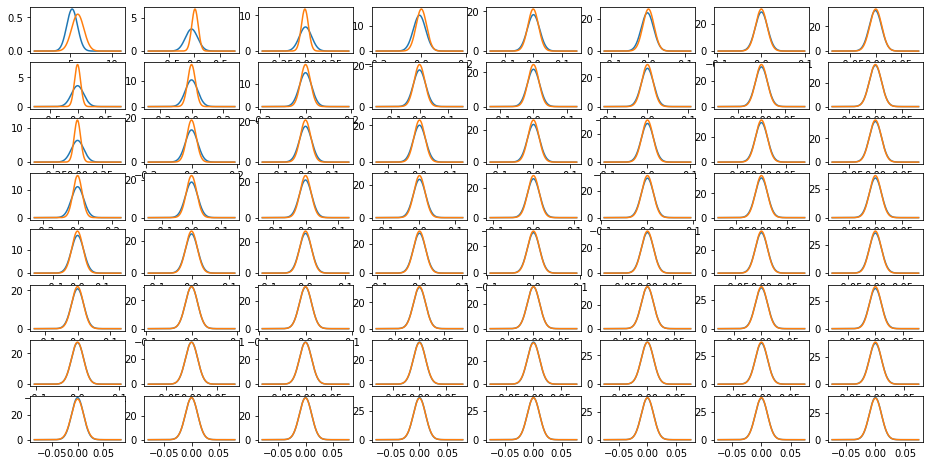

In [13]:
#marginal density plot
from scipy.stats import norm
from scipy.special import kl_div
import matplotlib.pyplot as plt
fig=plt.figure(figsize=(16,8))
KL_distance = []
mean_distance = np.zeros(foreground.shape[1])
for i in range(foreground.shape[1]):
    fig.add_subplot(8,8,i+1)
    x_FG = np.linspace(mean_FG[i] - 7 * se_FG[i] ,mean_FG[i] + 7 * se_FG[i],500)
    x_BG = np.linspace(mean_BG[i] - 7 * se_BG[i], mean_BG[i] + 7 * se_BG[i],500)
    x = np.sort(np.array([x_FG,x_BG]),axis = None)
    y_cheetah = norm.pdf(x,mean_FG[i],se_FG[i])
    y_grass = norm.pdf(x,mean_BG[i],se_BG[i])
    KL = kl_divergence(y_grass,y_cheetah)
    KL_distance.append(KL)
    mean_distance[i] = abs(mean_FG[i] - mean_BG[i])
    plt.plot(x,y_cheetah,x,y_grass)
#     title = "Fit result for the %d feature" %(i+1)
#     plt.title(title)
plt.show()

0 , 0 : 5.252495114458474e+48 , 538457089.1570781
0 , 1 : 1.6691040354542281e+69 , 3.658016415350634e+62
0 , 2 : 1.6649296329410138e+68 , 4.2223621986231826e+60
0 , 3 : 1.2079854003176143e+69 , 5.0108820130174295e+60
0 , 4 : 7.784646459223099e+64 , 2.602574428063809e+55
0 , 5 : 4.278634048640202e+63 , 1.2947562920133365e+52
0 , 6 : 1.0030686303062197e+66 , 1.0944439078996646e+55
0 , 7 : 3.864808036063878e+66 , 1.59786376507358e+54
0 , 8 : 3.4995607888616813e+67 , 1.5591926083324853e+54
0 , 9 : 5.427915225505639e+66 , 5.409175493486218e+55
0 , 10 : 5.484869211727914e+66 , 3.298527607505336e+57
0 , 11 : 2.918773558662189e+69 , 6.306778103872319e+59
0 , 12 : 1.0189539364279045e+72 , 5.5160074021544e+64
0 , 13 : 4.226205096329232e+74 , 1.3960486773848064e+70
0 , 14 : 1.292807969591109e+74 , 9.982036892162985e+69
0 , 15 : 1.4237232694016936e+74 , 6.867871542135712e+70
0 , 16 : 8.44488488075583e+73 , 1.1899119427238855e+71
0 , 17 : 1.2576514471338076e+71 , 2.2188354452583145e+68
0 , 18 : 2.3

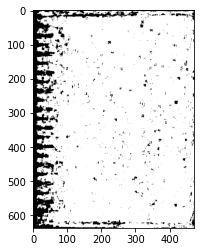

1268.5322706699371


In [17]:
from scipy.stats import multivariate_normal
import time
start = time.time()
from numpy.linalg import inv,det


cov_FG_inv = inv(cov_FG)
cov_BG_inv = inv(cov_BG)
cov_FG_det = det(cov_FG)
cov_BG_det = det(cov_BG)

for fname in glob.glob(path+'/*.Png'):  
    A = []
    serNum = fname.split('/')[6] 
    img  = cv.imread(fname)
    imgray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    imgray = (imgray-np.min(imgray))/(np.max(imgray) - np.min(imgray))
    im = imgray
    #imgFilt = cv.bilateralFilter(imgray, 15, 75, 75)
    #diag_img = signal.convolve2d(imgFilt, np.array(kern), boundary='symm', mode='same')
    #im = (diag_img+2)/4
    #im = (((diag_img+2))/4*255).astype(np.uint8) #bc min=-2 and max=+2
    im_array = np.array(im)
    for i in range(0,len(im_array)-8):
        for j in range(0,im_array.shape[1]-8):
            FG,BG = 0,0
            row_start,row_end = i,i+8
            col_start,col_end = j,j+8
            block = im_array[row_start:row_end,col_start:col_end]
            block_dct = dct2d(block).flatten()
            #block_dct = zig_zag_transform(block_dct)
            # foreground
    #         temp = block_dct - mean_FG
    #         temp1 = temp[:,np.newaxis]
    #         temp2 = (temp1.T.dot(cov_FG_inv)).dot(temp1)
    #         temp3 = np.log((2*np.pi)**64 * cov_FG_det) - 2 * np.log(prior_cheetah)
    #         FG = temp2 + temp3
            """
            calculating the likelihood that the input images' patch belongs to FG ie, crosshatch
            it's the conditional prob, given the mean and cov of the CH dct coeff
            what's the likelihood that the current input img's block/dct is FG/CH
            """
            FG = multivariate_normal.pdf(block_dct,mean=mean_FG,cov=cov_FG)*prior_ch
            #print(block_dct)
            #background
    #         temp = block_dct - mean_BG
    #         temp1 = temp[:,np.newaxis]
    #         temp2 = (temp1.T.dot(cov_BG_inv)).dot(temp1)
    #         temp3 = np.log((2*np.pi)**64 * cov_BG_det) - 2 * np.log(prior_grass)
    #         BG = temp2 + temp3
            BG = multivariate_normal.pdf(block_dct,mean=mean_BG,cov=cov_BG)*prior_chNot
            print(i,',',j,':',FG,',',BG)
            if (FG) >= (BG):
                A.append(0)
            else:
                A.append(1) 
        print('row {} done!'.format(i))
    A = np.array(A)
    A_matrix = np.reshape(A,(i+1,j+1))
    plt.figure()
    plt.imshow(A_matrix, cmap="gray")
    plt.show()
    break

end = time.time()
print(end - start)
    

In [ ]:
A_matrix = np.reshape(A,(638,473))

In [ ]:
plt.figure()
plt.imshow(A_matrix, cmap="gray")
plt.show()

In [ ]:
print(A_matrix)

In [ ]:
ch_dct[0]